# Confusion Matrix and Testing Models


- **Author**: Dan O'Connor
- **Notebook**: 9 of 9

Import required libraries

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from google.colab import drive #colab


In [ ]:
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [ ]:
cd '/content/gdrive/My Drive/Colab Notebooks'

/content/gdrive/My Drive/Colab Notebooks


Read in the dataset then split the variables then label encode the independent variable.

In [ ]:
subset_model_df = pd.read_csv('Data/subset_model_df.csv') 

In [ ]:
X = subset_model_df.drop(columns='genre_top')
y = subset_model_df['genre_top']

In [ ]:
from sklearn.preprocessing import LabelEncoder

# Encoder object
label_encoder = LabelEncoder()

# Fit the encoder on y
label_encoder.fit(y)

# Transform
y_encoded = label_encoder.transform(y)

Split into the same train test split as used throughout this analysis (random_state=1) then scale the data.

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y_encoded, test_size=0.25, stratify=y_encoded,random_state=1)

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler() #instaniate the scaler
X_train_scaled = scaler.fit_transform(X_train) #fit and transform onto x train
X_test_scaled = scaler.transform(X_test)  #transform x test

The neural net trained models were loaded in so I could inspect the confusion matrix.

In [ ]:
from tensorflow.keras.models import load_model 

In [ ]:
nn = load_model('Models/final_nn_model.h5') #load in optimized NN

For the optimized NN, it can be seen that it did not predict a single song as pop. Some of the more common misclassifications: electronic being classified as experimental and vise versa. Folk being classified as international and vice versa.

372/372 [==============================] - 2s 4ms/step


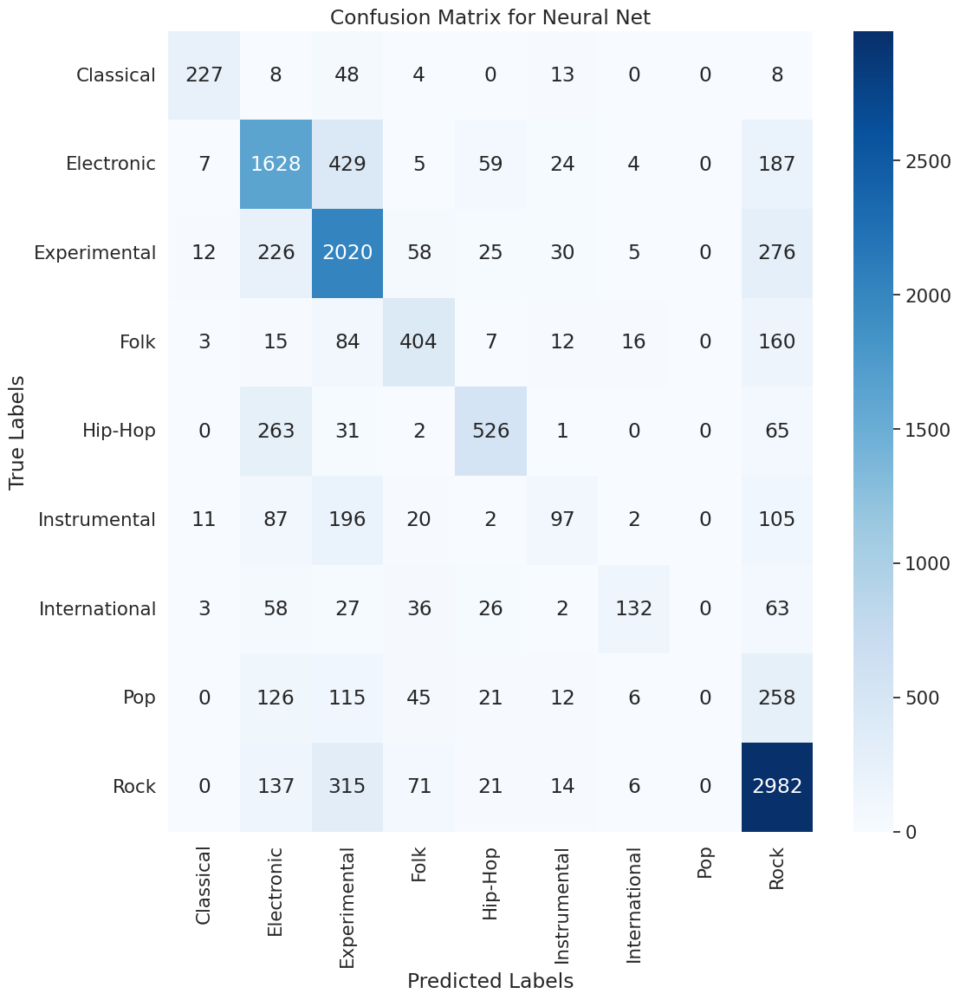

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns


y_pred_prob = nn.predict(X_test_scaled) 
y_pred = np.argmax(y_pred_prob, axis=1)
cm1 = confusion_matrix(y_test, y_pred) 
#plotconfusiion matrix
plt.figure(figsize=(12, 12))
sns.set(font_scale=1.4) # Adjust font size
sns.heatmap(cm1, annot=True, cmap="Blues", fmt='g',  #heatmap of the confusion matrix
            xticklabels=label_encoder.classes_,
            yticklabels=label_encoder.classes_) #str genres
plt.title("Confusion Matrix for Neural Net")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

The same confusion matrix (done on the same test data) with the SMOTE trained NN. The genre with the least misclassifications was classical. The model still confuses experimental and electronic and folk and international. However, this model correctly predicted pop songs while the above NN did not.

In [ ]:
snn = load_model('Models/final_smote_nn_model.h5')  #load in snn

372/372 [==============================] - 1s 3ms/step


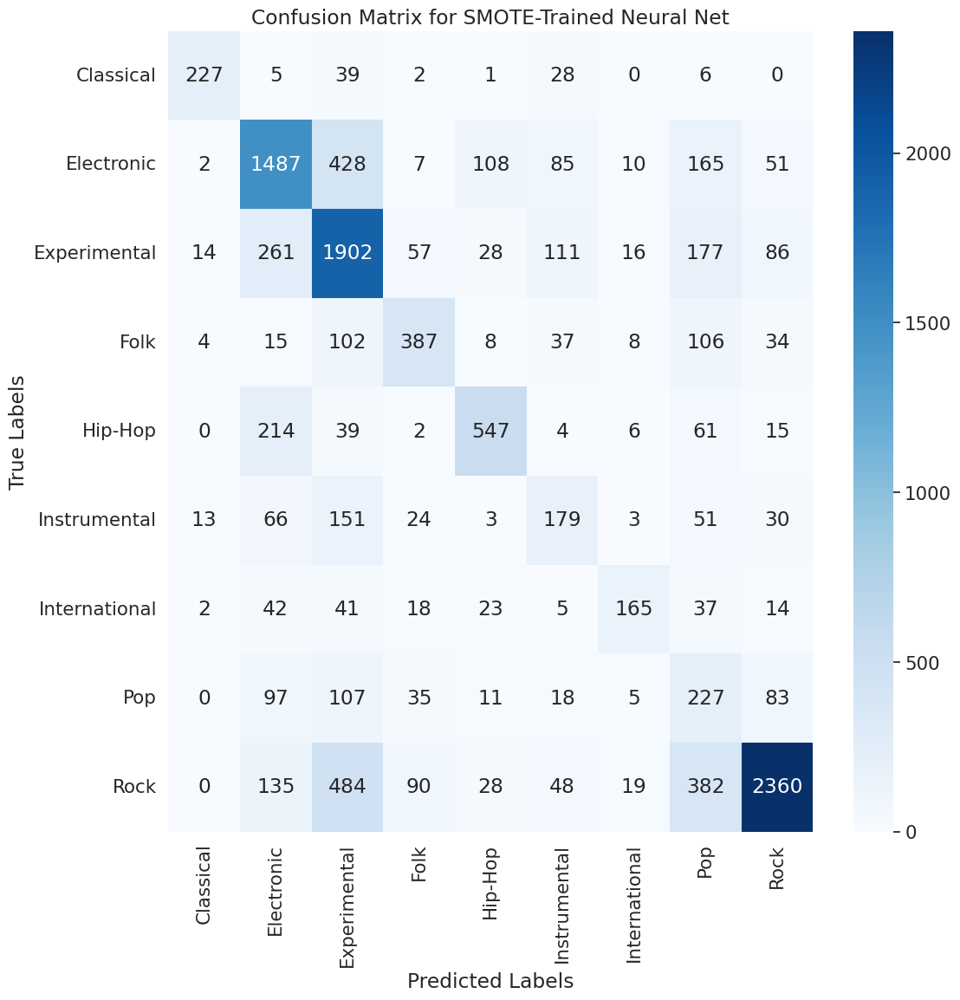

In [ ]:
y_pred_prob = snn.predict(X_test_scaled)
y_pred = np.argmax(y_pred_prob, axis=1)
cm2 = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(12, 12))
sns.set(font_scale=1.4) # Adjust font size
sns.heatmap(cm2, annot=True, cmap="Blues", fmt='g', 
            xticklabels=label_encoder.classes_,
            yticklabels=label_encoder.classes_)
plt.title("Confusion Matrix for SMOTE-Trained Neural Net")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

The final section will play some of the songs that are completely unseen to the model in both training and testing. This is because these songs have multiple parent genres. This section is purely for fun to visualize the soft predictions of my models. I am going to be using the random forest, NN, and SMOTE trained NN.

In [ ]:
#read in orginal DF
features_df = pd.read_csv('Data/features_single_header.csv', index_col='track_id')

In [ ]:
#filter out the features the model was NOT trained on
testing_df = features_df.iloc[:, list(range(85)) + list(range(253, len(features_df.columns)))]



In [ ]:
from joblib import load 
rf = load('Models/random_forest.joblib')#load in the random forest

Below is the first song I am testing. Referents by the Bird Names. This song is labeled as experimental rock and pop. 

In [ ]:
from IPython.display import Audio
audio_file = 'Audio/Bird Names - Referents.mp3' 
Audio(audio_file, autoplay=False)


Below I defined a function that outputs the soft probabilites for the three models.

In [ ]:
def genre_proba(sample, title):
    genres= label_encoder.classes_
    #SNN pred
    y_pred_prob_snn = snn.predict(sample)
    y_pred_prob_snn = y_pred_prob_snn[0]

    #NN pred
    y_pred_prob_nn = nn.predict(sample)
    y_pred_prob_nn = y_pred_prob_nn[0]

    #RF pred
    y_pred_prob_rf = rf.predict_proba(sample.reshape(1, -1))[0]

    #subplots
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(15, 5))

    # Plot SMOTE-trained Neural Net
    axs[0].bar(genres, y_pred_prob_snn)
    axs[0].set_title('SMOTE-trained Neural Net')
    axs[0].set_xlabel('Genre')
    axs[0].set_ylabel('Probability')
    axs[0].set_ylim([0, 1])
    axs[0].set_xticks(np.arange(len(genres)))
    axs[0].set_xticklabels(genres, rotation=90)

    #plot NN
    axs[1].bar(genres, y_pred_prob_nn)
    axs[1].set_title('Neural Net')
    axs[1].set_xlabel('Genre')
    axs[1].set_ylabel('Probability')
    axs[1].set_ylim([0, 1])
    axs[1].set_xticks(np.arange(len(genres)))
    axs[1].set_xticklabels(genres, rotation=90)

    #plot RF
    axs[2].bar(genres, y_pred_prob_rf)
    axs[2].set_title('Random Forest')
    axs[2].set_xlabel('Genre')
    axs[2].set_ylabel('Probability')
    axs[2].set_ylim([0, 1])
    axs[2].set_xticks(np.arange(len(genres)))
    axs[2].set_xticklabels(genres, rotation=90)

    plt.suptitle(f'Predicted Probabilities for {title}', fontsize=16)
    plt.tight_layout()
    # plt.savefig(f'{sample}.png')   
    plt.show()


Below shows the soft predictions. Very interesting how technically all models got it correct since it has multiple parent genres but they indexed differently.

1/1 [==============================] - 0s 35ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


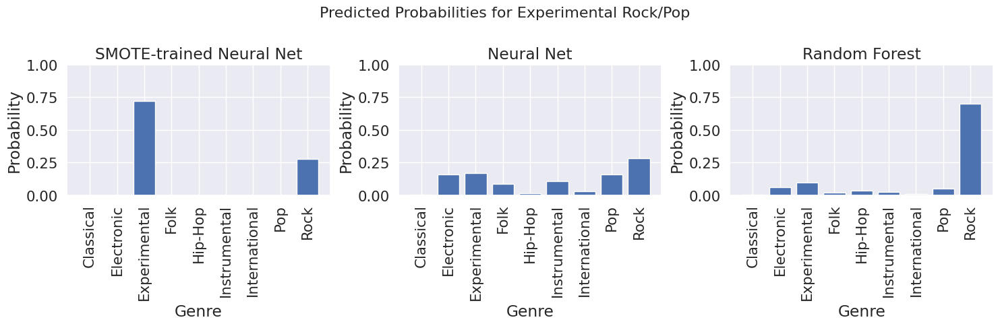

In [ ]:
experimental_rock_pop = testing_df.loc[246].values.reshape(1, -1) # it was track id 246 in the original DF
genre_proba(experimental_rock_pop, 'Experimental Rock/Pop')

The next song I tested was Frenetic by Audio/Nomina. This song is both experimental and electronic. Below shows that again all three models got it 'correct', but the NN's banked heavily on the experimental side while the RF captured more of the electronic aspect.

In [ ]:
from IPython.display import Audio
audio_file = 'Audio/Nonima - Frenetic (ft. theAudiologist).mp3'
Audio(audio_file, autoplay=False)

1/1 [==============================] - 0s 124ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


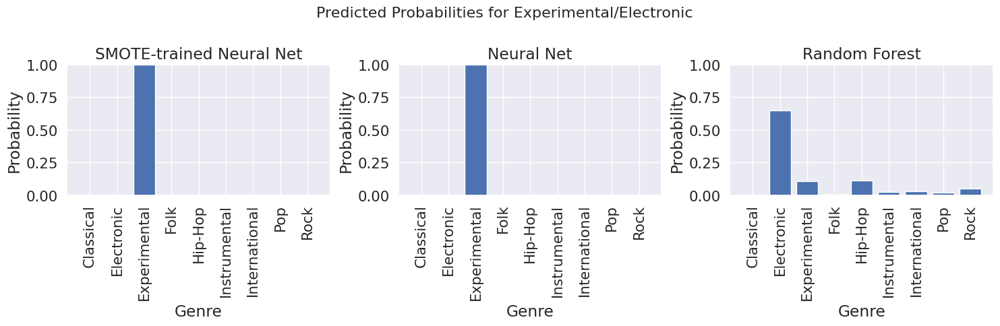

In [ ]:
experimental_electronic = testing_df.loc[53431].values.reshape(1, -1)
genre_proba(experimental_electronic, 'Experimental/Electronic')